<a href="https://colab.research.google.com/github/danielledong/customer_segmentation/blob/main/Customer_Personality_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

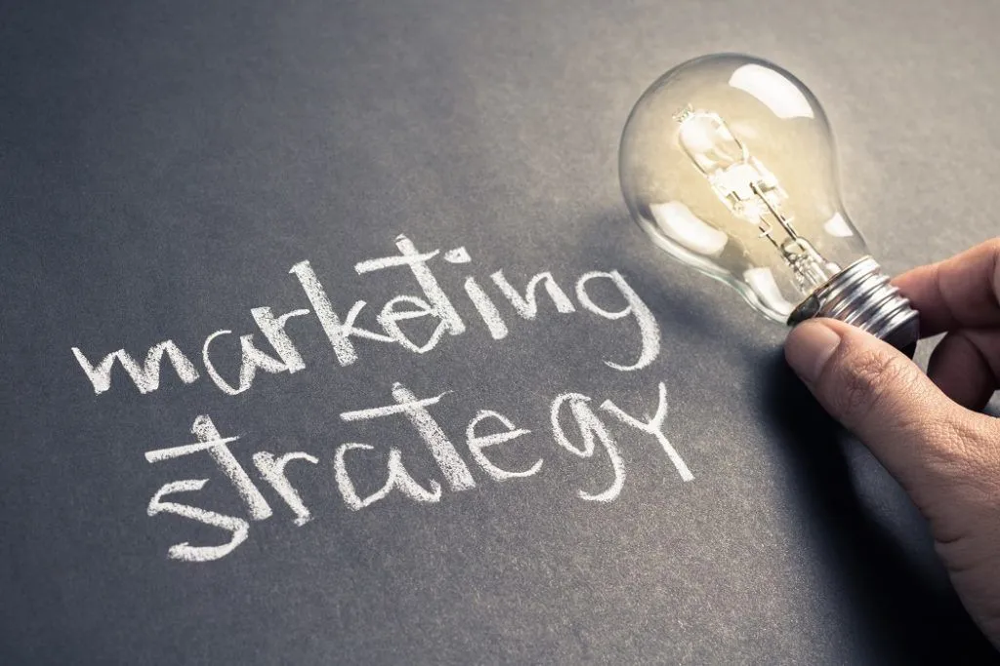
Source: https://corporatefinanceinstitute.com/resources/management/marketing-strategy/

# **Customer Analysis for Optimizing Marketing Campaigns**

**Author:** Danielle Dong

**Objective:**

The primary objective of this project is to analyze customer data to optimize marketing strategies by identifying distinct customer segments. By understanding the different profiles and behaviors of each customer segment, the goal is to tailor marketing campaigns to increase engagement, drive sales, and enhance overall customer satisfaction.

**Technologies and Tools Used:**

* Programming Languages: Python (for data analysis and ML modeling)
* Libraries: Scikit-Learn (for clustering algorithms), Pandas, NumPy (for data manipulation), Matplotlib, Seaborn (for data visualization)
* Data Source: https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis


**Expected Outcomes:**

* Improved targeting of marketing campaigns leading to increased customer engagement and higher sales conversion rates.
* Enhanced customer satisfaction through personalized offers and promotions.
* More efficient allocation of marketing resources by focusing on high-value segments and optimizing campaign effectiveness.

# **Import libraries:**

In [ ]:
!pip install ydata-profiling
!pip install matplotlib-pyplot

ERROR: Could not find a version that satisfies the requirement matplotlib-pyplot (from versions: none)
ERROR: No matching distribution found for matplotlib-pyplot


In [ ]:
import numpy as np
import pandas as pd
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.colors import ListedColormap
import seaborn as sns
sns.set(style="white", color_codes = True)

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering

from sklearn import metrics
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

import warnings
import sys
if not sys.warnoptions:
  warnings.simplefilter("ignore")



# **EDA - Reading Dataset:**

In [ ]:
df = pd.read_csv('marketing_campaign.csv', sep = '\t')
print('Number of rows:',len(df))
df.head()

Number of rows: 2240


,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


## **Columns description:**
##People

* ID: Customer's unique identifier
* Year_Birth: Customer's birth year
* Education: Customer's education level
* Marital_Status: Customer's marital status
* Income: Customer's yearly household income
* Kidhome: Number of children in customer's household
* Teenhome: Number of teenagers in customer's household
* Dt_Customer: Date of customer's enrollment with the company
* Recency: Number of days since customer's last purchase
* Complain: 1 if the customer complained in the last 2 years, 0 otherwise

##Products

* MntWines: Amount spent on wine in last 2 years
* MntFruits: Amount spent on fruits in last 2 years
* MntMeatProducts: Amount spent on meat in last 2 years
* MntFishProducts: Amount spent on fish in last 2 years
* MntSweetProducts: Amount spent on sweets in last 2 years
* MntGoldProds: Amount spent on gold in last 2 years

##Promotion

* NumDealsPurchases: Number of purchases made with a discount
* AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
* AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
* AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
* AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
* AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
* Response: 1 if customer accepted the offer in the last campaign, 0 otherwise

##Place

* NumWebPurchases: Number of purchases made through the company’s website
* NumCatalogPurchases: Number of purchases made using a catalogue
* NumStorePurchases: Number of purchases made directly in stores
* NumWebVisitsMonth: Number of visits to company’s website in the last month

In [ ]:
df.info()
cols_to_change = ['Education','Marital_Status','Dt_Customer']

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

## **Observation:**
1. "Income" column has missing values.
2. "Education", "Marital_Status", "Dt_Customer" have data type as object.
3. Categorical features should be encoded.




In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,2240.0,5592.159821,3246.662198,0.0,2828.25,5458.5,8427.75,11191.0
Year_Birth,2240.0,1968.805804,11.984069,1893.0,1959.00,1970.0,1977.00,1996.0
Income,2216.0,52247.251354,25173.076661,1730.0,35303.00,51381.5,68522.00,666666.0
Kidhome,2240.0,0.444196,0.538398,0.0,0.00,0.0,1.00,2.0
Teenhome,2240.0,0.506250,0.544538,0.0,0.00,0.0,1.00,2.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0


In [ ]:
# this tool also helps exploring data
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Cleaning

## Step 1: Drop Nulls
Drop rows were "Income" values are missing (since there are only 24/2240 rows affected)

In [ ]:
df_clean = df.dropna()
print('Number of rows after dropping nulls value:',len(df))

Number of rows after dropping nulls value: 2240


## Step 2: Convert "Dt_Customer" column to datetime


In [ ]:
df_clean['Dt_Customer'] = pd.to_datetime(df_clean['Dt_Customer'],format = "%d-%m-%Y")
dates = []
for i in df_clean['Dt_Customer']:
  dates.append(i.date())
print('Latest enrollment date:',max(dates))
print('Earliest enrollment date:',min(dates))

Latest enrollment date: 2014-06-29
Earliest enrollment date: 2012-07-30


<ipython-input-74-8164283da1b6>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



To effectively classify our clients, it is essential to understand the duration of their enrollment in our service. This insight helps tailor services and identify customer behavior trends over time.

In [ ]:
# create a feature "Customer_For":
days = []
newest_client = max(dates)
for date in dates:
  days.append((newest_client - date).days)
df_clean['Customer_For'] = days
df_clean['Customer_For'] = pd.to_numeric(df_clean['Customer_For'], errors = "coerce") #errors = "coerce" will replace invalid parsing as NaN

<ipython-input-75-531f5cadb006>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-75-531f5cadb006>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2216 entries, 0 to 2239
Data columns (total 30 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2216 non-null   int64         
 1   Year_Birth           2216 non-null   int64         
 2   Education            2216 non-null   object        
 3   Marital_Status       2216 non-null   object        
 4   Income               2216 non-null   float64       
 5   Kidhome              2216 non-null   int64         
 6   Teenhome             2216 non-null   int64         
 7   Dt_Customer          2216 non-null   datetime64[ns]
 8   Recency              2216 non-null   int64         
 9   MntWines             2216 non-null   int64         
 10  MntFruits            2216 non-null   int64         
 11  MntMeatProducts      2216 non-null   int64         
 12  MntFishProducts      2216 non-null   int64         
 13  MntSweetProducts     2216 non-null   i

## Step 3: explore & transform categorical data


In [ ]:
df_num = df_clean.select_dtypes("number")
df_cat = df_clean.select_dtypes("object")
print('Numerical features:',df_num.columns)
print('Categorical features:',df_cat.columns)

Numerical features: Index(['ID', 'Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5',
       'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Z_CostContact',
       'Z_Revenue', 'Response', 'Customer_For'],
      dtype='object')
Categorical features: Index(['Education', 'Marital_Status'], dtype='object')


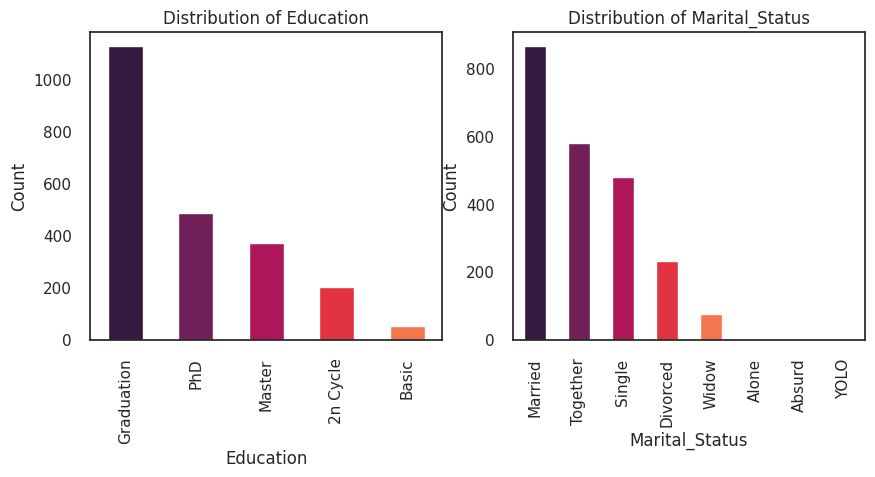

In [ ]:
# Distribution of categorical features
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
palette = sns.color_palette("rocket")

# Columns to plot
columns = df_cat.columns

# Loop through the columns and axes
for i, col in enumerate(columns):
    titles = f'Distribution of {col}'
    x_labels = f'{col}'
    df[col].value_counts().plot(kind='bar', ax=axes[i], title=titles, color = palette)
    axes[i].set_xlabel(x_labels)
    axes[i].set_ylabel('Count')

plt.tight_layout
plt.show()


In [ ]:
# We will transform "Education" values to "Undergrad" vs "Postgrad" and "Marital_Status" values to "Single" versus "Couple":
df_clean['Marital_Status_Simple'] = df_clean['Marital_Status'].replace({"Married":"Couple",
                                                            "Together":"Couple",
                                                            "Single":"Single",
                                                            "Divorced":"Single",
                                                            "Widow":"Single",
                                                            "Alone": "Single",
                                                            "Absurd":"Single",
                                                            "YOLO":"Single"
                                                              })
df_clean['EducationSimple'] = df_clean['Education'].replace({"Graduation":"Grad",
                                                 "PhD":"Postgrad",
                                                 "Master":"Postgrad",
                                                 "Basic":"Undergrad",
                                                 "2n Cycle":"Undergrad"
                                                 })


<ipython-input-79-95d14ba744c4>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-79-95d14ba744c4>:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
print("Unique values of Marital_Status:", df_clean['Marital_Status_Simple'].unique())
print("Unique values of Education:", df_clean['EducationSimple'].unique())


Unique values of Marital_Status: ['Single' 'Couple']
Unique values of Education: ['Grad' 'Postgrad' 'Undergrad']


## Step 4: explore and transform numerical data

In [ ]:
#Create "Age" column based on "Year_Birth":
df_clean['Age'] = 2024  - df_clean['Year_Birth']

#Create "Total_expenses" = expenses on diffent products
df_clean['Expenses'] = df_clean['MntWines'] + df_clean['MntFruits'] + df_clean['MntMeatProducts'] + df_clean['MntFishProducts'] + df_clean['MntSweetProducts'] + df_clean['MntGoldProds']

#Create "Total_children" = number of children in a household:
df_clean['Total_children'] = df_clean['Kidhome'] + df_clean['Teenhome']

#Create "Is_parent" = if they have kids or not:
df_clean['Is_parent'] = np.where(df_clean['Total_children'] > 0, 1, 0)

#Create "Total_purchase" column to get sum of all purchases made from different types:
df_clean['Total_purchase'] = df_clean['NumDealsPurchases'] + df_clean['NumWebPurchases'] + df_clean['NumCatalogPurchases'] + df_clean['NumStorePurchases']

#Create "Total_accepted_cmp" to get the sum of all marketing campaign accepted by each client:
df_clean['Total_accepted_cmp'] = df_clean['AcceptedCmp1'] + df_clean['AcceptedCmp2'] + df_clean['AcceptedCmp3'] + df_clean['AcceptedCmp4'] + df_clean['AcceptedCmp5']

#Rename product columns:
df_clean = df_clean.rename(columns={"MntWines":"Wines","MntFruits":"Fruits","MntMeatProducts":"Meat","MntFishProducts":"Fish","MntSweetProducts":"Sweets","MntGoldProds":"Gold"})

#Drop redundant columns: "Z_CostContact","Z_Revenue" are not relevant
to_drop = ["Marital_Status","Education","Year_Birth","ID","Z_CostContact","Z_Revenue","Dt_Customer"]
df_final = df_clean.drop(to_drop,axis=1)


<ipython-input-81-9c09f4bd5bb6>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-9c09f4bd5bb6>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-9c09f4bd5bb6>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-9c09f4b

In [ ]:
df_final.describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2216.0,52247.251354,25173.076661,1730.0,35303.0,51381.5,68522.00,666666.0
Kidhome,2216.0,0.441787,0.536896,0.0,0.0,0.0,1.00,2.0
Teenhome,2216.0,0.505415,0.544181,0.0,0.0,0.0,1.00,2.0
Recency,2216.0,49.012635,28.948352,0.0,24.0,49.0,74.00,99.0
Wines,2216.0,305.091606,337.327920,0.0,24.0,174.5,505.00,1493.0
Fruits,2216.0,26.356047,39.793917,0.0,2.0,8.0,33.00,199.0
Meat,2216.0,166.995939,224.283273,0.0,16.0,68.0,232.25,1725.0
Fish,2216.0,37.637635,54.752082,0.0,3.0,12.0,50.00,259.0
Sweets,2216.0,27.028881,41.072046,0.0,1.0,8.0,33.00,262.0
Gold,2216.0,43.965253,51.815414,0.0,9.0,24.5,56.00,321.0


In [ ]:
# Label encoding the categorical columns

# Create a LabelEncoder object
le = LabelEncoder()

# Iterate through the categorical columns and apply label encoding
for column in df_final.select_dtypes("object"):
  df_final[column] = le.fit_transform(df_final[column])


# Correlation - HeatMap

By highlighting strongly correlated features, a heatmap helps in selecting or engineering features that could enhance model performance or simplify the dataset.

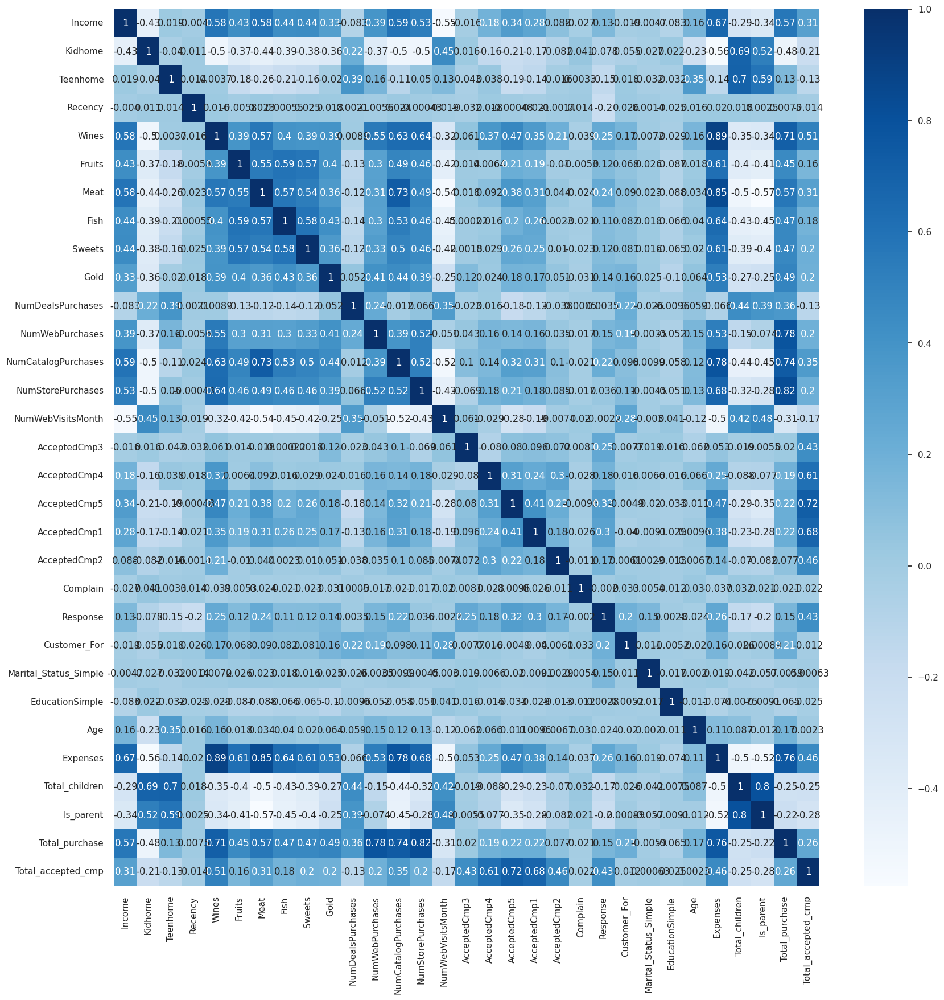

In [ ]:
# All features are now numerical, we check the correlation among the features
plt.figure(figsize = (20, 20))
sns.heatmap(df_final.corr(), annot=True, cmap="Blues")
plt.show()

#Data Analysis

##**1. Most popular product**

> Add blockquote



Buyer's preference analysis is essential for understanding customer needs, behaviors, and motivations.

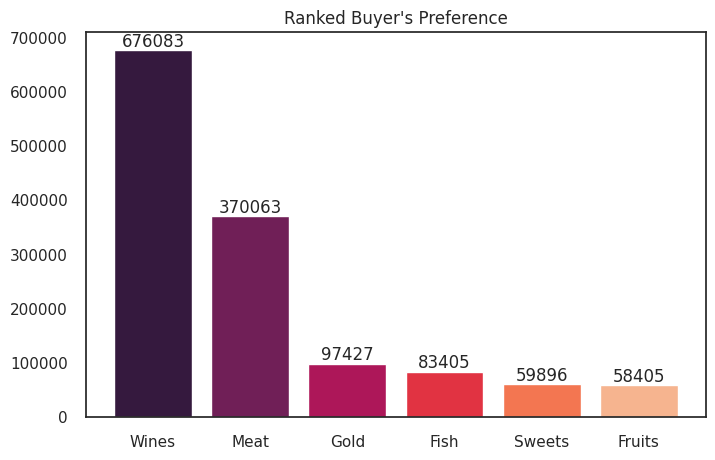

In [ ]:
product = pd.DataFrame({"Wines": df_final['Wines'].sum(),
                        "Fruits": df_final['Fruits'].sum(),
                        "Meat": df_final['Meat'].sum(),
                        "Fish": df_final['Fish'].sum(),
                        "Sweets": df_final['Sweets'].sum(),
                        "Gold": df_final['Gold'].sum()}, index=[0])

# Transpose the DataFrame to make products rows
product_transposed = product.T
product_transposed.columns = ['Quantity']  # Rename the column for clarity

# Rank by the value in the first row (quantities) and sort
ranked_product = product_transposed.sort_values(by='Quantity', ascending=False)

fig, ax = plt.subplots(figsize=(8, 5))
bars = ax.bar(ranked_product.index, ranked_product['Quantity'], color=palette)

ax.bar_label(bars)
plt.title("Ranked Buyer's Preference")
plt.show()


##**2. Most successfull campaign**

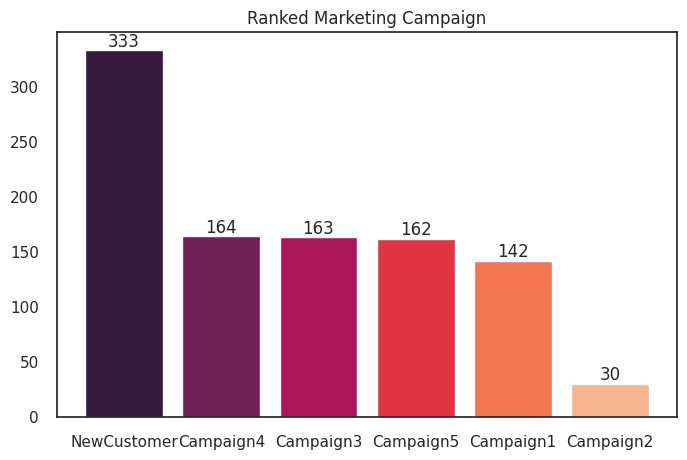

In [ ]:
campaign = pd.DataFrame({"Campaign1": df_final['AcceptedCmp1'].sum(),
                        "Campaign2": df_final['AcceptedCmp2'].sum(),
                        "Campaign3": df_final['AcceptedCmp3'].sum(),
                        "Campaign4": df_final['AcceptedCmp4'].sum(),
                        "Campaign5": df_final['AcceptedCmp5'].sum(),
                        "NewCustomer": df_final['Response'].sum()}, index=[0])

# Transpose the DataFrame to make products rows
campaign_transposed = campaign.T
campaign_transposed.columns = ['Total']  # Rename the column for clarity

# Rank by the value in the first row (quantities) and sort
ranked_campaign = campaign_transposed.sort_values(by='Total', ascending=False)

fig, ax = plt.subplots(figsize=(8, 5))
bars = ax.bar(ranked_campaign.index, ranked_campaign['Total'], color=palette)

ax.bar_label(bars)
plt.title("Ranked Marketing Campaign")
plt.show()

##**3. Most popular purchase method**

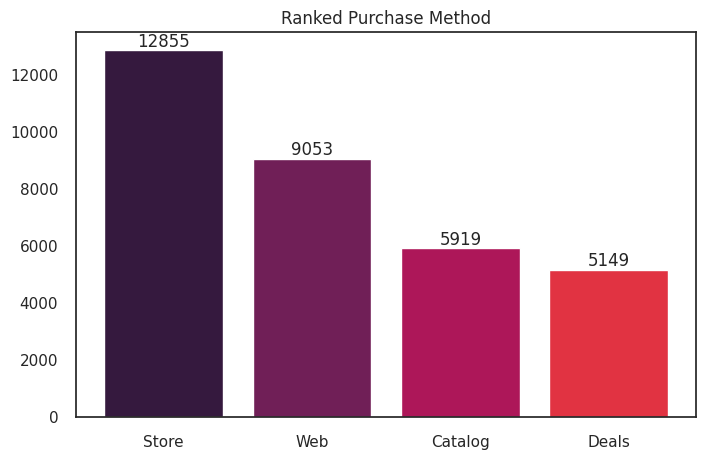

In [ ]:
purc_method = pd.DataFrame({"Web": df_final['NumWebPurchases'].sum(),
                        "Catalog": df_final['NumCatalogPurchases'].sum(),
                        "Store": df_final['NumStorePurchases'].sum(),
                        "Deals": df_final['NumDealsPurchases'].sum()}, index=[0])

# Transpose the DataFrame to make products rows
purc_method_transposed = purc_method.T
purc_method_transposed.columns = ['Total']  # Rename the column for clarity

# Rank by the value in the first row (quantities) and sort
ranked_purc_method= purc_method_transposed.sort_values(by='Total', ascending=False)

fig, ax = plt.subplots(figsize=(8, 5))
bars = ax.bar(ranked_purc_method.index, ranked_purc_method['Total'], color=palette)

ax.bar_label(bars)
plt.title("Ranked Purchase Method")
plt.show()

## **4. Correlation between "Income" and "Expenses"**

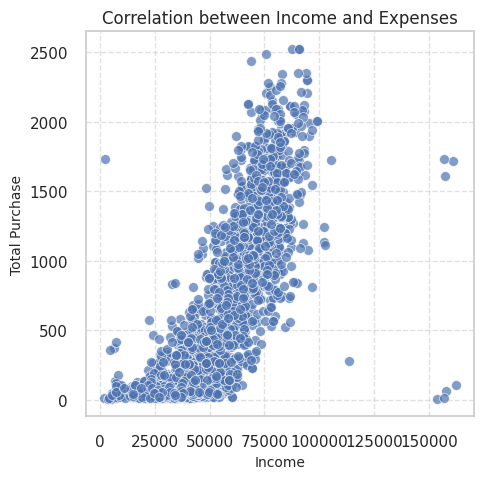

In [ ]:
# Set the style for the plot
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(5, 5))
sns.scatterplot(x='Income', y='Expenses', data=df_final[df_final['Income']<200000],
                marker='o', s=50, color='b', alpha=0.7)

# Add titles and labels
plt.title('Correlation between Income and Expenses', fontsize=12)
plt.xlabel('Income', fontsize=10)
plt.ylabel('Total Purchase', fontsize=10)

# Add gridlines for better readability
plt.grid(True, linestyle='--', alpha=0.6)

# Show the plot
plt.show()


##**Findings**

- Wines are the most popular product, accounting for 50.3% of total sales.

- The latest marketing campaign has been the most successful, performing 67% better than the average of all previous campaigns, with 198.8 promotional offers accepted.

- The in-store sales method is the most effective, with orders 56% higher than the average, totaling 8,244 orders.

- There is a strong correlation between income and total purchases. However, the spread of values increases at higher income levels, indicating more variability in spending habits among wealthier customers.



# Data Preprocessing

Data need to be processed before clustering:

1 - Label encoding the categorical features

2 - Scaling the features using the stard scaler

3 - Creating a subset dataframe for dimensionality reduction

In [ ]:
# Label encoding the categorical columns

# Create a LabelEncoder object
le = LabelEncoder()

# Iterate through the categorical columns and apply label encoding
for column in df_final.select_dtypes("object"):
  df_final[column] = le.fit_transform(df_final[column])

In [ ]:
#drop the features on deals accepted, complain and promotion (these are the outcomes we want to look at) and some features that don't have a strong correlation
dataset = df_final.copy()
to_delete = ['AcceptedCmp1','AcceptedCmp2','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response','Complain','Total_children','Is_parent','Kidhome','NumWebVisitsMonth','Wines','Fruits','Meat','Fish','Sweets','Gold']
dataset = dataset.drop(to_delete,axis=1)
#scaling
scaler = StandardScaler()
scaler.fit(dataset)
dataset_scaled = pd.DataFrame(scaler.transform(dataset), columns = dataset.columns)
dataset_scaled.head()


,Income,Teenhome,Recency,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Customer_For,Marital_Status_Simple,EducationSimple,Age,Expenses,Total_purchase,Total_accepted_cmp
0,0.234063,-0.928972,0.310532,0.351713,1.428553,2.504712,-0.554143,1.529129,1.348829,-0.894187,0.986443,1.675488,1.319446,-0.439265
1,-0.234559,0.909066,-0.380509,-0.168231,-1.125881,-0.571082,-1.169518,-1.188411,1.348829,-0.894187,1.236801,-0.962358,-1.157987,-0.439265
2,0.769478,-0.928972,-0.795134,-0.688176,1.428553,-0.229327,1.291982,-0.205155,-0.741384,-0.894187,0.318822,0.280250,0.797881,-0.439265
3,-1.017239,-0.928972,-0.795134,-0.168231,-0.760962,-0.912837,-0.554143,-1.059945,-0.741384,-0.894187,-1.266777,-0.919224,-0.897205,-0.439265
4,0.240221,-0.928972,1.554407,1.391603,0.333796,0.112428,0.061232,-0.951244,-0.741384,0.569268,-1.016420,-0.307044,0.537099,-0.439265


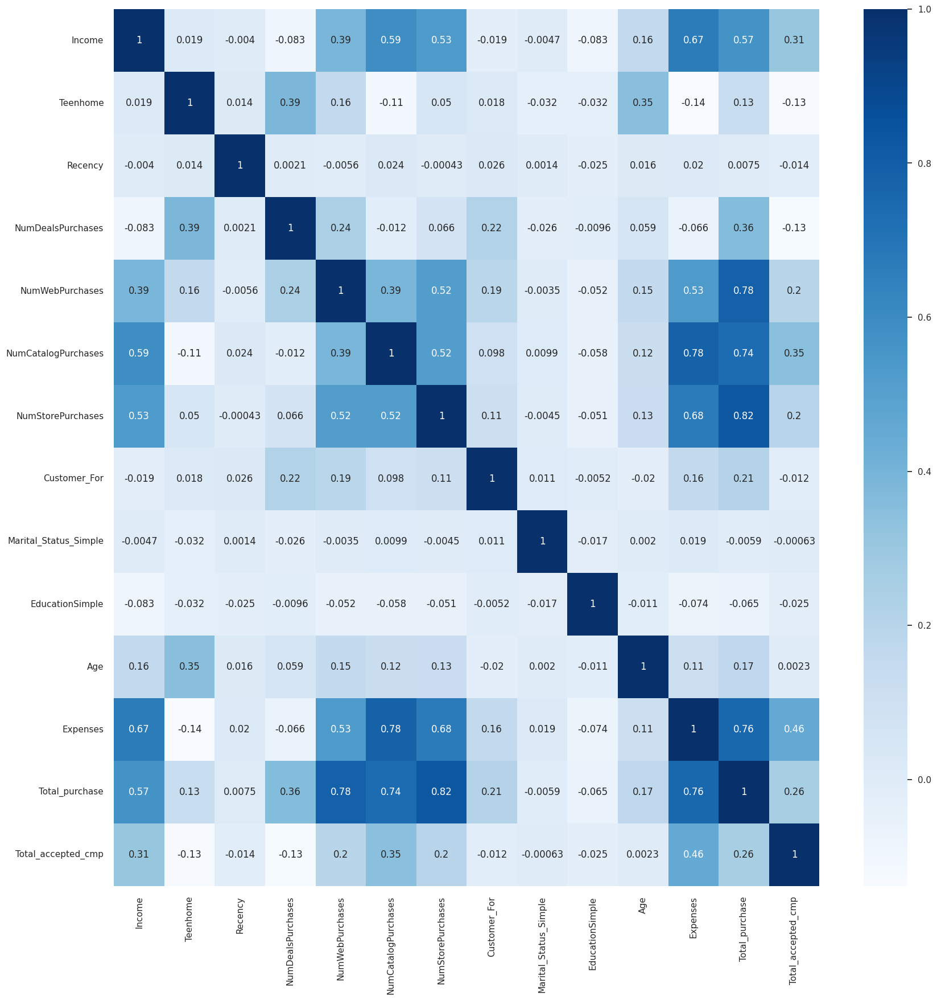

In [ ]:
plt.figure(figsize = (20, 20))
sns.heatmap(dataset.corr(), annot=True, cmap="Blues")
plt.show()

**Summary:**

* Dropping Outcome Features: Remove target variables (like whether they accepted campaigns) so that the model can learn from the remaining features without being influenced by already known outcomes.

* Scaling: Standardize the remaining features to ensure the model treats all variables equally, regardless of their original scale.

Why StandardScaler? The StandardScaler specifically standardizes by subtracting the mean and dividing by the standard deviation. This is commonly used when you want to standardize normally distributed data.

# **Dimensionality reduction**

Dimensionality reduction is a technique used in data preprocessing and machine learning to reduce the number of input variables (features) in a dataset. The goal is to simplify the dataset while retaining as much relevant information as possible.

Dimensionality reduction is important for:

* **Improving model performance** by focusing on the most important features.
* **Reducing computational cost** and memory usage.
* **Removing noise** and redundant features to create a cleaner dataset.
* **Avoiding multicollinearity** and simplifying model interpretability.
* **Enabling better visualization** of high-dimensional data.

Principal Component Analysis (PCA) is a dimensionality reduction technique used to simplify large datasets by transforming them into fewer variables (called principal components) that capture the most important information.

In [ ]:
!pip install prince

In [ ]:
pca = PCA(n_components=3)
pca.fit(dataset_scaled)
PCA_ds = pd.DataFrame(pca.transform(dataset_scaled), columns = ['PC1','PC2','PC3'])
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
PC1,2216.0,-9.939903e-17,2.088751,-3.808339,-2.057650,-0.043604,1.812750,7.238800
PC2,2216.0,6.412841e-17,1.347249,-3.977427,-1.027342,-0.047774,0.922187,5.097745
PC3,2216.0,1.362729e-17,1.093957,-4.294229,-0.753118,-0.006579,0.764201,5.336095


In [ ]:
import plotly.express as px

# Create the 3D scatter plot with enhanced aesthetics
fig = px.scatter_3d(
    PCA_ds,
    x='PC1',
    y='PC2',
    z='PC3',
    title='3D Scatter Plot of PCA Components',
    opacity=0.5,  # Make markers slightly transparent
    template='plotly_dark'  # Use a dark theme for better contrast
)

# Update layout to improve the appearance
fig.update_layout(
    title_font=dict(size=20, family='Arial', color='white'),  # Adjust title font
    scene=dict(
        xaxis_title='PC 1',
        yaxis_title='PC 2',
        zaxis_title='PC 3',
        xaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
        yaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
        zaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
    ),
    margin=dict(l=0, r=0, b=0, t=40),  # Adjust plot margins
)
fig.update_traces(marker=dict(size=3))

# Show the updated plot
fig.show()


# **Clustering**

Clustering helps discover natural groupings in data. Key steps include choosing an algorithm, preprocessing data, determining the number of clusters, fitting the model, and evaluating the results.

1. Use Elbow Method: The Elbow Method is used to determine the optimal number of clusters in a clustering algorithm like K-Means.

2. Clustering by using Agglomerative clustering

3. Evaluate



/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will 

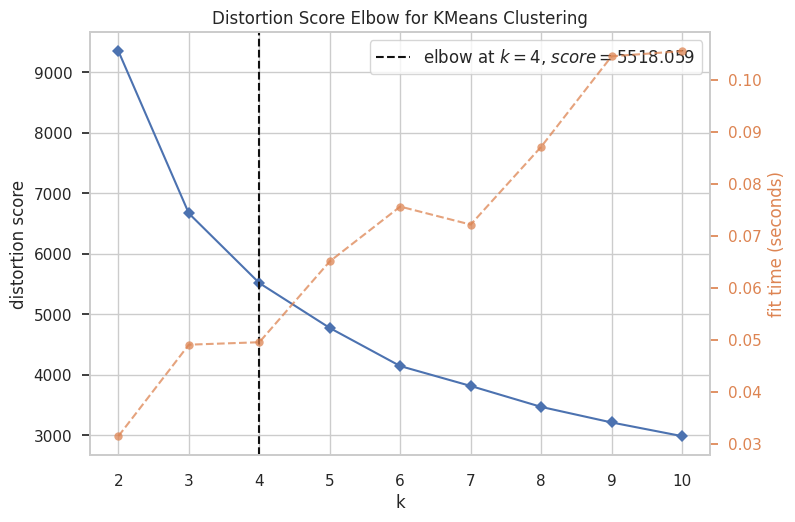

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [125]:
# Elbow Method to decide # clusters:
elbow_m = KElbowVisualizer(KMeans(),k=(2,11))
elbow_m.fit(PCA_ds)
elbow_m.show()

Based on the result about, k=4 would be the optimal number of clusters for this data. We will fit the Agglomerative Clustering Model to get the final clusters.


In [117]:
# prompt: write code to fit and predict by using Agglomerative clustering model to PCA_ds

agg_model = AgglomerativeClustering(n_clusters=3)
clusters_predict = agg_model.fit_predict(PCA_ds)
PCA_ds['Clusters'] = clusters_predict
dataset['Clusters'] = clusters_predict
df_final['Clusters'] = clusters_predict
df_clean['Clusters'] = clusters_predict



In [ ]:
#plotting the clusters, color set to cluster column
fig = px.scatter_3d(
    PCA_ds,
    x='PC1',
    y='PC2',
    z='PC3',
    title='3D Scatter Plot of PCA Components',
    color = 'Clusters',
    opacity=0.5,  # Make markers slightly transparent
    template='plotly_dark'  # Use a dark theme for better contrast
)

# Update layout to improve the appearance
fig.update_layout(
    title_font=dict(size=20, family='Arial', color='white'),  # Adjust title font
    scene=dict(
        xaxis_title='PC 1',
        yaxis_title='PC 2',
        zaxis_title='PC 3',
        xaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
        yaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
        zaxis=dict(showbackground=True, backgroundcolor='lightgrey'),
    ),
    margin=dict(l=0, r=0, b=0, t=40),  # Adjust plot margins
)
fig.update_traces(marker=dict(size=4))

# Show the updated plot
fig.show()

# **Evaluation**


**1. Silhouette Score**

**Definition:** Measures how similar a point is to its own cluster compared to other clusters.

**Range:** -1 to 1 (higher values indicate better clustering).

**Interpretation:**

* A score close to 1 indicates that data points are well-clustered.

* A score close to 0 indicates overlapping clusters.

* A score close to -1 indicates incorrect clustering.



**2.Calinski-Harabasz Index (Variance Ratio Criterion)**

**Definition:** Measures the ratio of the sum of between-cluster dispersion to within-cluster dispersion.

**Interpretation:** Higher scores indicate better-defined clusters.


**3.Davies-Bouldin Index**

**Definition:** Measures the average similarity ratio of each cluster to its most similar cluster.

**Range:** Lower values indicate better clustering, as it represents a lower ratio of intra-cluster to inter-cluster distances.



In [118]:
results = {
    "Number of Clusters": [],
    "Silhouette Score": [],
    "Calinski Harabasz Score": [],
    "Davies-Bouldin Score": []
}

n_clusters = range(2, 10)

for n in n_clusters:
    agg_model = AgglomerativeClustering(n_clusters=n)
    clusters_predict = agg_model.fit_predict(PCA_ds)

    # Calculate scores
    silhouette_avg = silhouette_score(PCA_ds, clusters_predict)
    score_CH = calinski_harabasz_score(PCA_ds, clusters_predict)
    score_DB = davies_bouldin_score(PCA_ds, clusters_predict)

    # Append results to the dictionary
    results["Number of Clusters"].append(n)
    results["Silhouette Score"].append(silhouette_avg)
    results["Calinski Harabasz Score"].append(score_CH)
    results["Davies-Bouldin Score"].append(score_DB)

# Convert the results dictionary into a DataFrame
df_results = pd.DataFrame(results)

# Print the DataFrame
display(df_results)


,Number of Clusters,Silhouette Score,Calinski Harabasz Score,Davies-Bouldin Score
0,2,0.425663,1954.385316,0.936951
1,3,0.398652,1663.774063,1.150401
2,4,0.329596,1434.809247,1.141067
3,5,0.301215,1349.661234,1.168210
4,6,0.319501,1365.683132,1.147569
5,7,0.311999,1248.157309,1.134838
6,8,0.296592,1167.383446,1.168248
7,9,0.303989,1116.169769,1.141166


**4. Dendrogram Visualization**

* Definition: A dendrogram is a tree-like diagram that shows the hierarchy of clusters created by Agglomerative Clustering.

* Interpretation: By visually inspecting the dendrogram, you can identify an appropriate number of clusters by cutting the tree at a certain level.


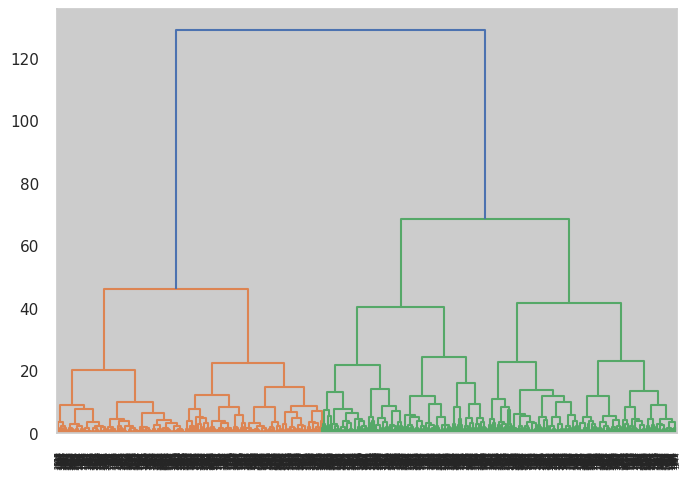

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
linked = linkage(PCA_ds, 'ward')
dendrogram(linked)
plt.show()

**5. Cluster Size Distribution**

* **Definition:** Checks if clusters are balanced or have appropriate sizes.
* **Interpretation:** Look for clusters that are not too small or too large relative to the dataset size. A significant imbalance might indicate poor clustering

<ipython-input-100-d1eb46e2edbe>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




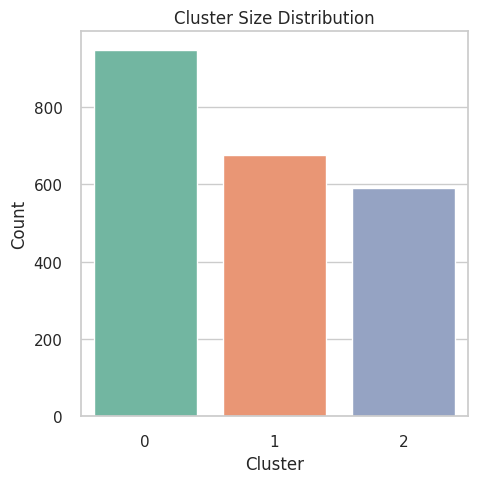

Clusters seem fairly distributed


In [ ]:
plt.figure(figsize=(5, 5))
clusters_plot = sns.countplot(x='Clusters', data=df_final, palette = 'Set2')
plt.title('Cluster Size Distribution')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

print("Clusters seem fairly distributed")



<ipython-input-101-c71490a65b38>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




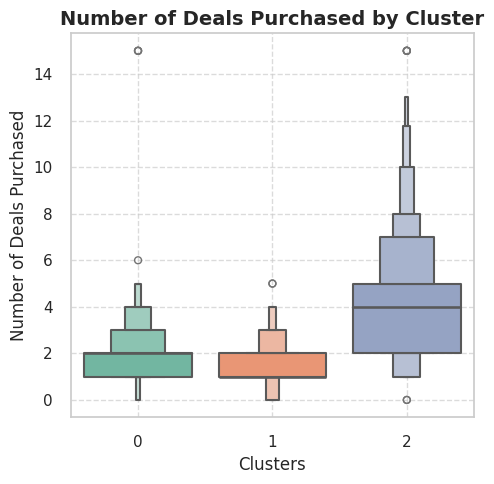

In [ ]:
# Set the figure size
plt.figure(figsize=(5, 5))

# Create the boxen plot with enhanced aesthetics
deals_clusters = sns.boxenplot(
    y=df_final['NumDealsPurchases'],
    x=df_final['Clusters'],
    palette='Set2',  # Use a pleasant color palette
    linewidth=1.5    # Add border width for the plot lines
)

# Set title and labels with improved font size
deals_clusters.set_title("Number of Deals Purchased by Cluster", fontsize=14, weight='bold')
deals_clusters.set_xlabel("Clusters", fontsize=12)
deals_clusters.set_ylabel("Number of Deals Purchased", fontsize=12)

# Adjust grid style for clarity
deals_clusters.grid(True, linestyle='--', alpha=0.7)

# Display the plot
plt.tight_layout()  # Ensure layout fits within the figure area
plt.show()


<function matplotlib.pyplot.show(close=None, block=None)>

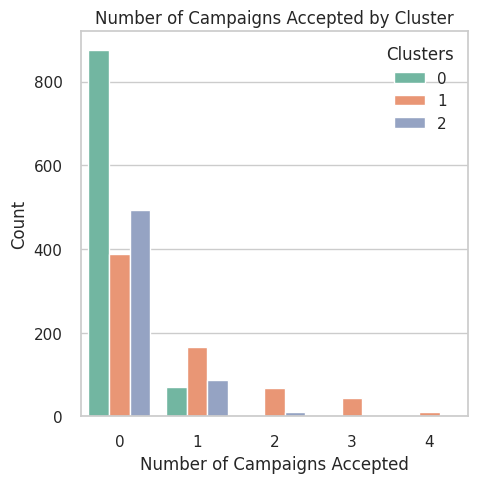

In [ ]:
df_final['Total_promo'] = df_final['AcceptedCmp1'] + df_final['AcceptedCmp2'] + df_final['AcceptedCmp3'] + df_final['AcceptedCmp4'] + df_final['AcceptedCmp5']
plt.figure(figsize=(5, 5))
pl = sns.countplot(x=df_final['Total_promo'], hue=df_final['Clusters'], palette = "Set2")
pl.set_title('Number of Campaigns Accepted by Cluster')
pl.set_xlabel('Number of Campaigns Accepted')
pl.set_ylabel('Count')
plt.show

## **Conclusion**
Although the elbow method initially suggested 5 clusters, the test scores, cluster distribution, and dendrogram analysis indicate that the optimal number of clusters is 3. This choice yields the highest Silhouette and Calinski-Harabasz scores, along with the lowest Davies-Bouldin score, confirming better clustering performance.

There has not been an overwhelming response to the campaigns so far. Very few participants overall. Moreover, no one part take in all 5 of them. Perhaps better-targeted and well-planned campaigns are required to boost sales.

# **Profiling**

## Distribution of each features by clusters

In [ ]:
print(df_final.columns)

Index(['Income', 'Kidhome', 'Teenhome', 'Recency', 'Wines', 'Fruits', 'Meat',
       'Fish', 'Sweets', 'Gold', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Customer_For',
       'Marital_Status_Simple', 'EducationSimple', 'Age', 'Expenses',
       'Total_children', 'Is_parent', 'Total_purchase', 'Total_accepted_cmp',
       'Clusters', 'Total_promo'],
      dtype='object')


<ipython-input-116-eeb5bccf9c26>:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-116-eeb5bccf9c26>:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-116-eeb5bccf9c26>:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-116-eeb5bccf9c26>:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-116-eeb5bccf9c26>:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated a

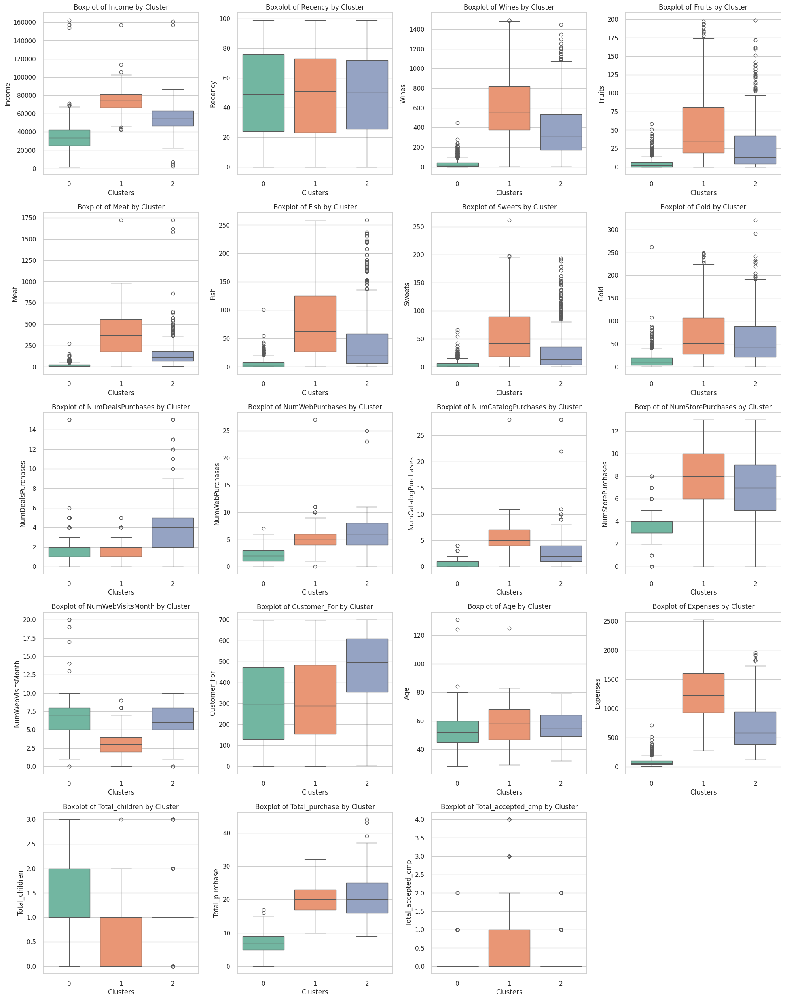

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select numerical columns to plot
df_profil = df_final[df_final["Income"] < 600000].copy()  # Only one value with income >60000 so we drop it

columns_to_plot = ['Income', 'Recency', 'Wines', 'Fruits', 'Meat',
                   'Fish', 'Sweets', 'Gold', 'NumDealsPurchases', 'NumWebPurchases',
                   'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
                    'Customer_For',
                    'Age', 'Expenses',
                   'Total_children', 'Total_purchase', 'Total_accepted_cmp']

# Determine the number of rows and columns for the subplot grid
n_rows = 8
n_cols = 4

# Create a figure and set of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 40))
axes = axes.flatten()  # Flatten the 2D array of axes to make it easier to iterate

# Plot boxplots for each numerical column
for i, column in enumerate(columns_to_plot):
    sns.boxplot(x='Clusters', y=column, data=df_profil, palette="Set2", ax=axes[i])  # Adjust palette as needed
    axes[i].set_title(f'Boxplot of {column} by Cluster')
    axes[i].set_xlabel('Clusters')
    axes[i].set_ylabel(column)

# Remove any unused subplots
for j in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()




### **Findings**

**1. Income by Cluster:**

- Cluster 1 has the highest median income, followed by Cluster 2, and then Cluster 0.

- The spread in Cluster 1 is quite large, indicating more variability in income for individuals in this cluster.

- Cluster 0 has the lowest and most tightly distributed income levels.

**2. Product Purchases** (Wines, Fruits, Meat, Fish, Sweets, Gold) by Cluster:

- Cluster 1 shows the highest median purchases for almost every product type (Wines, Fruits, Meat, Fish, Sweets, Gold).

- Cluster 0 consistently has the lowest purchases across all product categories, with very little variation.

- Cluster 2 generally falls in between, with moderate purchases and variability for most products.

**3. Number of Purchases by Cluster:**

- NumDealsPurchases and NumWebPurchases are highest in Cluster 2, suggesting that individuals in this cluster engage more in online and deal-based purchases.

- NumStorePurchases and NumCatalogPurchases are notably high in Cluster 1, indicating that in-store and catalog-based sales methods are more popular in this cluster.

- Cluster 0 again shows the lowest engagement across all purchasing channels.

**4. Marketing Campaigns by Cluster:**

- For accepted campaigns (Cmp1, Cmp2, Cmp3, Cmp4, Cmp5), most clusters have low acceptance rates, except for Cluster 1, which shows higher engagement in at least one campaign.

- Cluster 0 shows little to no engagement with marketing campaigns.

**5. Customer Behavior and Demographics by Cluster:**

- Age: Cluster 1 has older customers compared to Clusters 0 and 2.

- Expenses: Cluster 1 has the highest expenses, consistent with their high purchase volumes.

- Total Purchases: Cluster 1 leads in total purchases, while Cluster 0 has the fewest.




In [ ]:
cols_cat = ['Education','Marital_Status','Total_accepted_cmp', 'Complain', 'Is_parent', 'Total_children']
cols_distribution = ['Income', 'Recency' ]
cols_purchase = ['NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases']


##**Cluster 0 Profile**

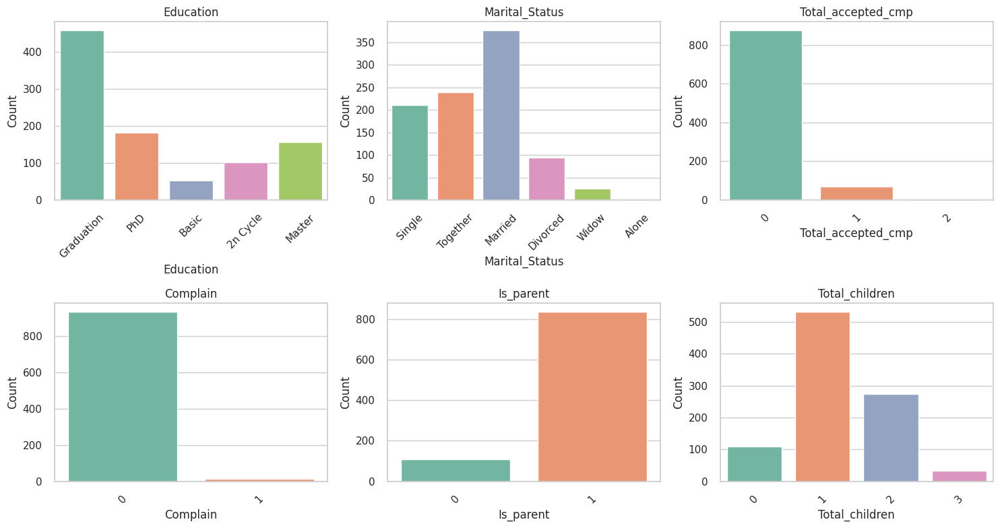

In [ ]:
df_cluster0 = df_clean[df_clean["Clusters"] == 0]
n_rows = 2
n_cols = 3

# Create a figure and set of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 8))
axes = axes.flatten()  # Flatten the 2D array of axes to make it easier to iterate

# Plot countplots for each categorical column
for i, column in enumerate(cols_cat):
    sns.countplot(x=column, hue = column , legend = False, data=df_cluster0, palette='Set2', ax=axes[i])
    axes[i].set_title(column)
    #axes[i].set_xlabel(column)
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

# Remove any unused subplots
for j in range(len(cols_cat), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

**Customer Profile for the Cluster 0**

* The most common customer type

- **Demographics:** Well-educated, mostly married parents with 1 or 2 children. They tend to have a high level of educational attainment, with many holding degrees or advanced qualifications.

- **Engagement:** They show low engagement with marketing campaigns, as most customers have not accepted any offers. This could suggest that marketing efforts may not be aligned with their interests or that they require different strategies to engage.

- **Complaints:** There are minimal complaints, indicating general satisfaction with the services or products.

- **Family-Oriented:** With a large proportion of parents and those having 1 or 2 children, this group may respond well to family-focused products or promotions.

## **Cluster 1 Profile**

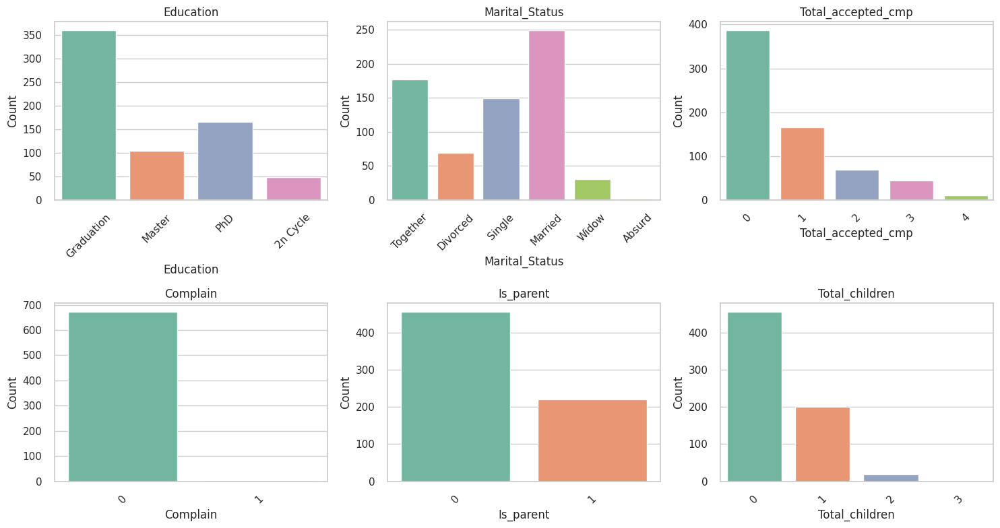

In [ ]:
df_cluster1 = df_clean[df_clean["Clusters"] == 1]
n_rows = 2
n_cols = 3

# Create a figure and set of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 8))
axes = axes.flatten()  # Flatten the 2D array of axes to make it easier to iterate

# Plot countplots for each categorical column
for i, column in enumerate(cols_cat):
    sns.countplot(x=column, hue = column , legend = False, data=df_cluster1, palette='Set2', ax=axes[i])
    axes[i].set_title(column)
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

# Remove any unused subplots
for j in range(len(cols_cat), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

**Customer Profile for the Cluster 1**

* Most likely DINKs (Double income without kids)

- **Demographics:** Well-educated, mostly couples without children. They tend to have a higher level of education than cluster 0.

- **Engagement:** They show higher engagement with marketing campaigns. While most people did not accepted any promotion but the maximum of total accepted promo is 4/5 campaigns

- **Complaints:** There are 0 complaints, indicating general satisfaction with the services or products.



## **Cluster 2 Profile**

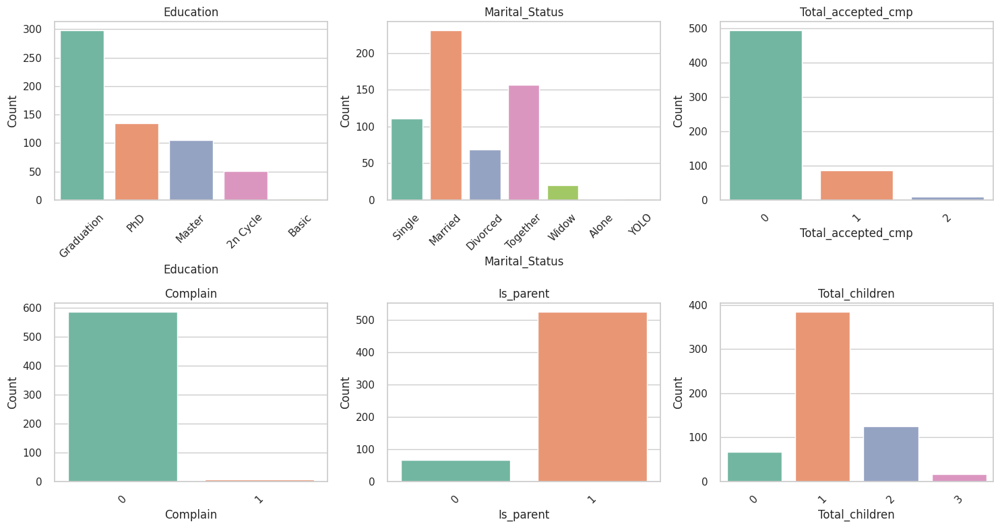

In [ ]:
df_cluster2 = df_clean[df_clean["Clusters"] == 2]
n_rows = 2
n_cols = 3

# Create a figure and set of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 8))
axes = axes.flatten()  # Flatten the 2D array of axes to make it easier to iterate

# Plot countplots for each categorical column
for i, column in enumerate(cols_cat):
    sns.countplot(x=column, hue = column , legend = False, data=df_cluster2, palette='Set2', ax=axes[i])
    axes[i].set_title(column)
    #axes[i].set_xlabel(column)
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

# Remove any unused subplots
for j in range(len(cols_cat), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

**Customer Profile for the Cluster 2**

* Similar to cluster 0 but made more purchases

- **Demographics:** Highly educated, mostly couples without 1 or 2. They tend to have a higher level of education and higher income than cluster 0.

- **Engagement:** They show higher engagement with marketing campaigns than cluster 0 but less than cluster 1. While most people did not accepted any promotion but the maximum of total accepted promo is 2/5 campaigns

- **Complaints:** There are minimal complaints same as cluster 0, indicating general satisfaction with the services or products.

# **Summary and conclusion**

**Cluster 1:** High Income, High Engagement (DINKs)

- Income: Highest median income with significant variability.
- Purchases: Highest across all product categories (Wines, Fruits, Meat, Fish, Sweets, Gold).
- Purchase Channels: High in-store and catalog purchases.
- Marketing Engagement: Most responsive to marketing campaigns, with several accepted offers.
- Demographics: Well-educated, mostly couples without children.
- Complaints: No complaints, indicating strong satisfaction.

**Cluster 2:** Moderate Income, Deal-Oriented Shoppers

- Income: Moderate income, higher than Cluster 0.
- Purchases: Mid-level purchases, more than Cluster 0 but less than Cluster 1.
- Purchase Channels: Highest in online and deal-based purchases.
- Marketing Engagement: Some engagement with marketing campaigns but less than Cluster 1.
- Demographics: Highly educated, mostly couples with 1 or 2 children.
- Complaints: Minimal complaints, reflecting general satisfaction.

**Cluster 0:** Low Income, Low Engagement

- Income: Lowest and most tightly distributed income.
- Purchases: Lowest across all product categories.
- Purchase Channels: Lowest engagement across all channels.
- Marketing Engagement: Little to no response to marketing campaigns.
- Demographics: Well-educated, mostly married parents with 1 or 2 children.
- Complaints: Minimal complaints, indicating general satisfaction.

**Conclusion and Marketing Strategy:**
- **Cluster 1:** Focus on luxury, premium products, and personalized campaigns. These customers have high spending power and engage well with targeted marketing. Enhance catalog and in-store experiences and promote exclusive, high-end offerings.

- **Cluster 2:** Emphasize online deals and discounts. This group responds well to promotions and deals, particularly through digital channels. Tailor online campaigns to boost engagement and increase deal-based purchases.

- **Cluster 0:** Requires a different approach. They are less responsive to campaigns and have lower spending. Focus on family-oriented products and promotions, possibly highlighting value and convenience to engage this cluster better. Consider refining marketing strategies to align with their needs and interests.
This segmentation allows the company to personalize marketing strategies for each cluster, maximizing engagement and revenue.